#  Linear regression

In this part of this exercise, you will implement linear regression with one
variable to predict profits for a food truck. Suppose you are the CEO of a
restaurant franchise and are considering different cities for opening a new
outlet. The chain already has trucks in various cities and you have data for
profits and populations from the cities.

The file ex1data1.txt contains the dataset for our linear regression problem. The first column is the population of a city and the second column is
the profit of a food truck in that city. A negative value for profit indicates a
loss

In [55]:
#from google.colab import files
#uploaded = files.upload()
#!ls

In [56]:
with open('ex1data1.txt', 'r') as archivo:
    contenido = archivo.read()

In [57]:
import numpy as np
import matplotlib.pyplot as plt

# Load data
data = np.loadtxt('ex1data1.txt', delimiter=',')  # Load the text file with a comma as a delimiter
print(data[0:5,:])
#load the data a create a np vectors X and y
X = data[:,0]  # las dos primeras columnas
y = data[:,1]   # la tercera columna



[[ 6.1101 17.592 ]
 [ 5.5277  9.1302]
 [ 8.5186 13.662 ]
 [ 7.0032 11.854 ]
 [ 5.8598  6.8233]]


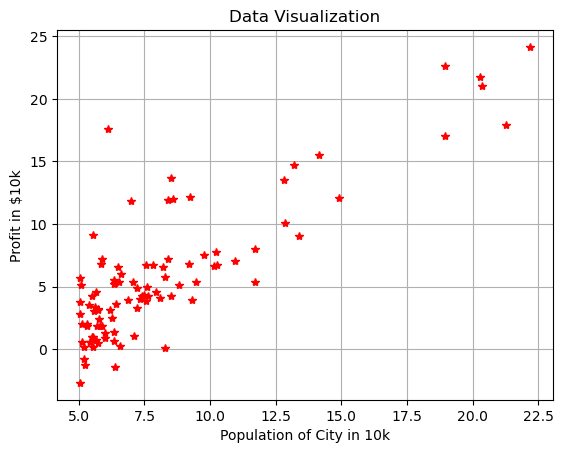

In [58]:
# ==================== Part 1: Plotting ====================


# Plot data
plt.plot(X, y, '*r', label='Profit')  # Red stars for positive examples
plt.grid(True)  # Turn on the grid
#plt.legend()    # Add legend
plt.xlabel('Population of City in 10k')  # Label for x-axis
plt.ylabel('Profit in $10k')  # Label for y-axis
plt.title('Data Visualization')  # Add a title
plt.show()

# Cost Function

The objective of linear regression is to minimize the cost function:
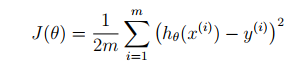

where the hypothesis h is given by

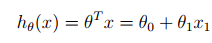

**Create a matrix by adding a column of ones to the vecto X**

You should expect to see a cost of approximately 32.07


In [ ]:
# using numpy and scipy
# Sigmoid function
from scipy.optimize import minimize

# Implement cost function
def cost_function(theta, X, y):
    m = len(y)
     # Instructions: Compute the cost of a particular choice of theta
    #               You should set J to the cost.
    predictions = X @ theta              # h_theta(x)
    errors = predictions - y
    J = (1 / (2 * m)) * np.sum(errors ** 2)
    return J

m = data.shape[0]
y = data[:, [1]]
X = data[:, [0]]  # Then, create a matrix by adding a column of ones to the vecto X

X = np.hstack([np.ones((m, 1)), X])  

theta = np.zeros((2, 1)) # Look that theta is a vector 2x1
print(f"Model parameters: {theta}")
print(f"Cost function: {cost_function(theta, X, y)}") #You should expect to see a cost of approximately 32.07


Model parameters: [[0.]
 [0.]]
Cost function: 32.072733877455676


# Gradient descent

Next, you will implement gradient descent in the file gradientDescent.m.
The loop structure has been written for you, and you only need to supply
the updates to θ within each iteration.

Using the following values:
iterations = 3
theta = np.zeros((2, 1))
alpha = 0.01

The first three iteration:

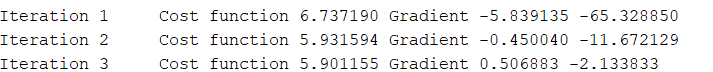



iteration 1  cost function: 6.737190  gradient -5.839135  -65.328850
iteration 2  cost function: 5.931594  gradient -0.450040  -11.672129
iteration 3  cost function: 5.901155  gradient 0.506883  -2.133833
iteration 4  cost function: 5.895229  gradient 0.675930  -0.438169
iteration 5  cost function: 5.890095  gradient 0.704925  -0.136637
iteration 6  cost function: 5.885004  gradient 0.709025  -0.082930
iteration 7  cost function: 5.879932  gradient 0.708701  -0.073277
iteration 8  cost function: 5.874879  gradient 0.707594  -0.071455
iteration 9  cost function: 5.869844  gradient 0.706348  -0.071026
iteration 10  cost function: 5.864827  gradient 0.705080  -0.070845
iteration 11  cost function: 5.859828  gradient 0.703810  -0.070707
iteration 12  cost function: 5.854847  gradient 0.702542  -0.070578
iteration 13  cost function: 5.849884  gradient 0.701275  -0.070451
iteration 14  cost function: 5.844939  gradient 0.700011  -0.070324
iteration 15  cost function: 5.840011  gradient 0.698

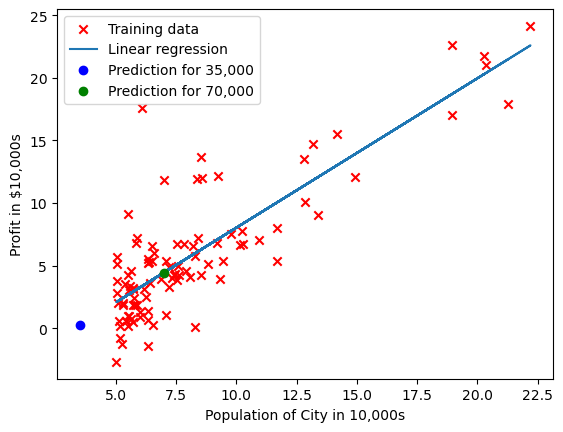

In [62]:
import numpy as np
import matplotlib.pyplot as plt
iterations = 300000
m = data.shape[0]
y = data[:, [1]]
X = data[:, [0]]
X = np.hstack([np.ones((m, 1)), X])
theta = np.zeros((2, 1))
alpha = 0.01




def gradient_descent(X, y, theta, alpha, iterations):
    m = len(y)
    J= np.zeros(iterations)

    for iter in range(iterations):
     #Instructions: Perform a single gradient step on the parameter vector
        #               theta.
        #
      # Hint: While debugging, it can be useful to print out the values
      #       of the cost function (computeCostMulti) and gradient here.
      # Save the cost J in every iteration

        predictions = X @ theta
        error = predictions - y
        gradient = (1 / m) * (X.T @ error)
        step = alpha * gradient
        theta = theta - step

        cost = cost_function(theta, X, y)
        J[iter] = cost

        # Imprimir la iteración, el costo y el gradiente negativo (valor restado a theta)
        gradient = gradient.flatten()  # negativo del gradiente
        gradient_str = '  '.join(f"{val:.6f}" for val in gradient)
        print(f"iteration {iter + 1}  cost function: {cost:.6f}  gradient {gradient_str}")

    return theta, J

# Ejecutar descenso por gradiente
theta, J = gradient_descent(X, y, theta, alpha, iterations)

# Predict values for population sizes of 35,000 and 70,000
predict1 = np.array([1, 3.5]) @ theta
print(f'For population = 35,000, we predict a profit of {(predict1 * 10000).item():.2f}')

predict2 = np.array([1, 7.0]) @ theta
print(f'For population = 35,000, we predict a profit of {(predict2 * 10000).item():.2f}')


# Plot the linear fit
plt.scatter(X[:, 1], y, color='red', marker='x', label='Training data')  # X[:,1] is the feature (since X[:,0] is the bias term)
plt.plot(X[:, 1], X @ theta, label='Linear regression')  # X @ theta gives the predicted values
plt.xlabel('Population of City in 10,000s')
plt.ylabel('Profit in $10,000s')
plt.plot(3.5, predict1.item(), 'ob', label='Prediction for 35,000')
plt.plot(7.0, predict2.item(), 'og', label='Prediction for 70,000')
plt.legend()
plt.show()


# Visualization

Visualizing J(theta_0, theta_1) ...


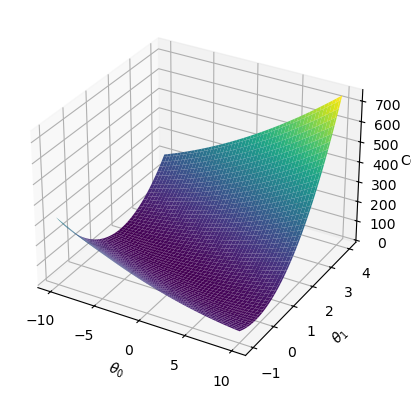

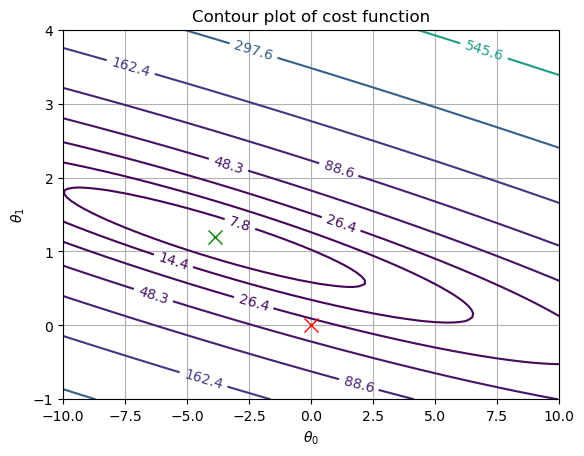

In [61]:
from mpl_toolkits.mplot3d import Axes3D  # Needed for 3D plots

print('Visualizing J(theta_0, theta_1) ...')

theta_init = np.zeros((2, 1))
# Grid over which we will calculate J
theta0_vals = np.linspace(-10, 10, 100)
theta1_vals = np.linspace(-1, 4, 100)

# Initialize J_vals to a matrix of 0's
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# Fill out J_vals
for i in range(len(theta0_vals)):
    for j in range(len(theta1_vals)):
        t = np.array([[theta0_vals[i]], [theta1_vals[j]]])
        J_vals[i, j] = cost_function(t, X, y)

# Transpose J_vals to match the orientation of MATLAB's surf
J_vals = J_vals.T

# Surface plot
theta0_vals_mesh, theta1_vals_mesh = np.meshgrid(theta0_vals, theta1_vals)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(theta0_vals_mesh, theta1_vals_mesh, J_vals, cmap='viridis')
ax.set_xlabel(r'$\theta_0$')
ax.set_ylabel(r'$\theta_1$')
ax.set_zlabel('Cost')

# Contour plot
plt.figure()
cp = plt.contour(theta0_vals, theta1_vals, J_vals, levels=np.logspace(-2, 3, 20))
plt.clabel(cp)
plt.xlabel(r'$\theta_0$')
plt.ylabel(r'$\theta_1$')

# Plot the final theta found by gradient descent
plt.plot(theta_init[0, 0], theta_init[1, 0], 'rx', markersize=10, linewidth=2)
plt.plot(theta[0, 0], theta[1, 0], 'gx', markersize=10, linewidth=2)
plt.title('Contour plot of cost function')
plt.grid(True)
plt.show()
